SSAU 2023 6231-010402D  Nepryahin Bogdan

## Подключение необходимых библиотек

In [1]:
from plotnine import *
from plotnine.data import *

import numpy as np
import pandas as pd

import warnings

## Тестовый датафрейм "mpg"

In [2]:
mpg

,manufacturer,model,displ,year,cyl,trans,drv,cty,hwy,fl,class
0,audi,a4,1.8,1999,4,auto(l5),f,18,29,p,compact
1,audi,a4,1.8,1999,4,manual(m5),f,21,29,p,compact
2,audi,a4,2.0,2008,4,manual(m6),f,20,31,p,compact
3,audi,a4,2.0,2008,4,auto(av),f,21,30,p,compact
4,audi,a4,2.8,1999,6,auto(l5),f,16,26,p,compact
...,...,...,...,...,...,...,...,...,...,...,...
229,volkswagen,passat,2.0,2008,4,auto(s6),f,19,28,p,midsize
230,volkswagen,passat,2.0,2008,4,manual(m6),f,21,29,p,midsize
231,volkswagen,passat,2.8,1999,6,auto(l5),f,16,26,p,midsize
232,volkswagen,passat,2.8,1999,6,manual(m5),f,18,26,p,midsize


## Простейшая визуализация с использованиме geom_point по осям displ и hwy

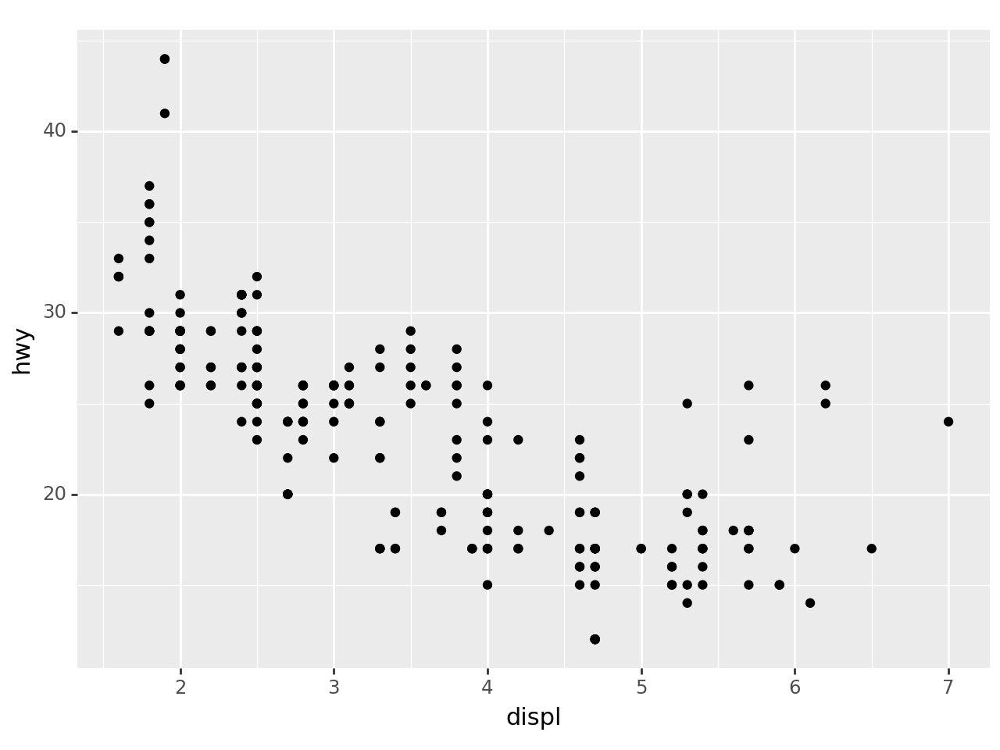

<Figure Size: (640 x 480)>

In [3]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy"))

### Постройте два графика: в одном из них одна из осей должна быть соответствовать столбцу с элементами-категориями, во втором – обе (например, "class" и "drv")


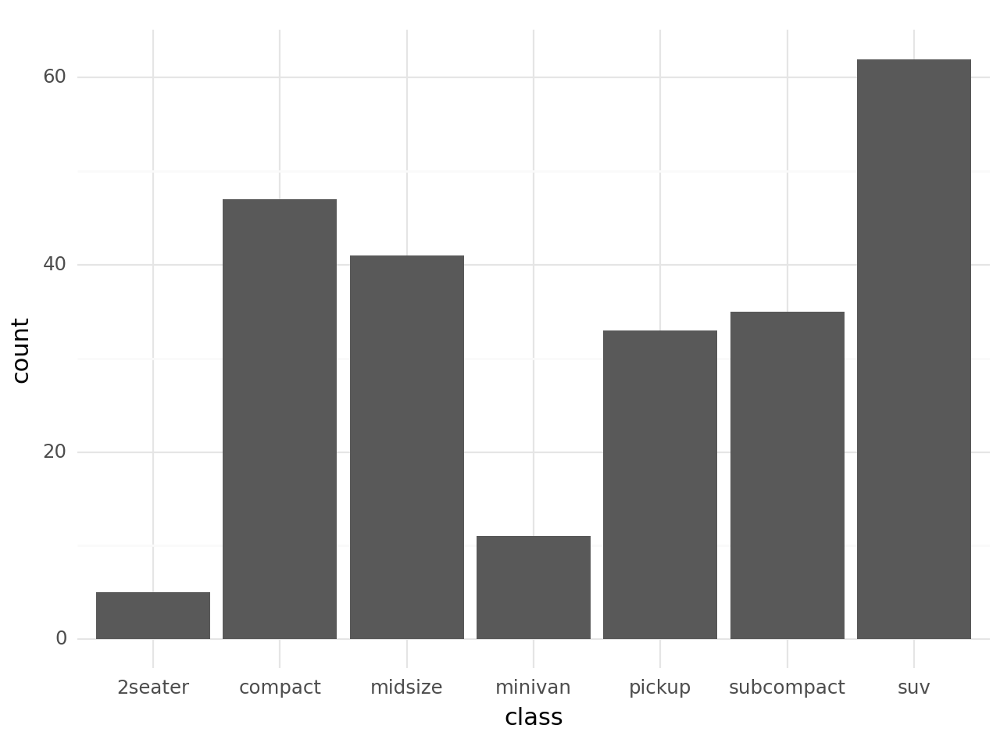

In [4]:

# Игнорировать предупреждения
warnings.filterwarnings('ignore')

# Загрузить данные mpg
mpg_data = mpg

# Первый график: одна ось - столбец "class"
p = ggplot(mpg_data, aes(x='class')) + geom_bar() + theme_minimal()
print(p)

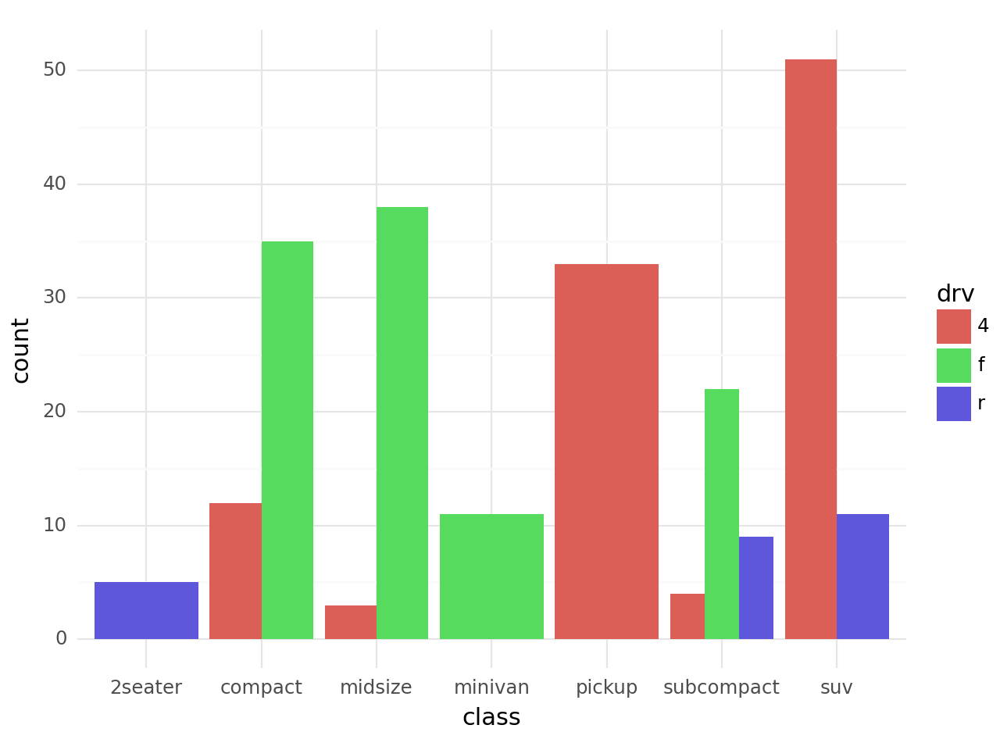

In [5]:
# Второй график: обе оси - "class" и "drv"
p = ggplot(mpg_data, aes(x='class', fill='drv')) + geom_bar(position='dodge') + theme_minimal()
print(p)

## Добавим красок, оттенков и форм в графики

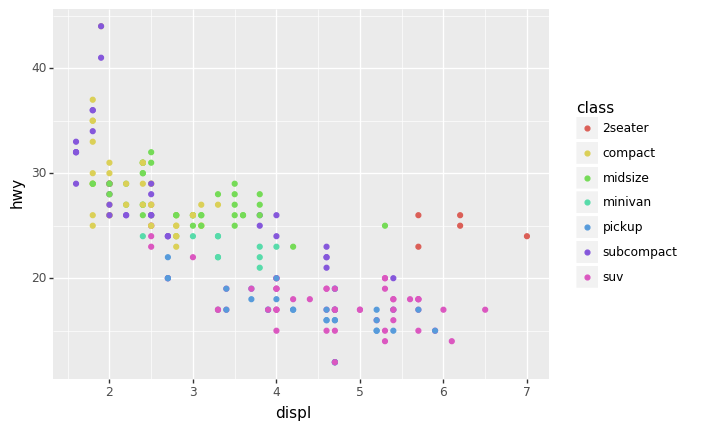

<ggplot: (-9223371871808279888)>

In [6]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy", color="class"))

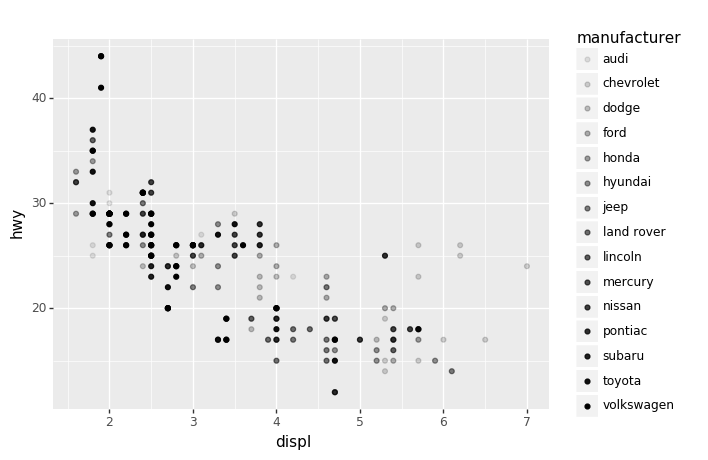

<ggplot: (-9223371871808766956)>

In [7]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy", alpha="manufacturer"))

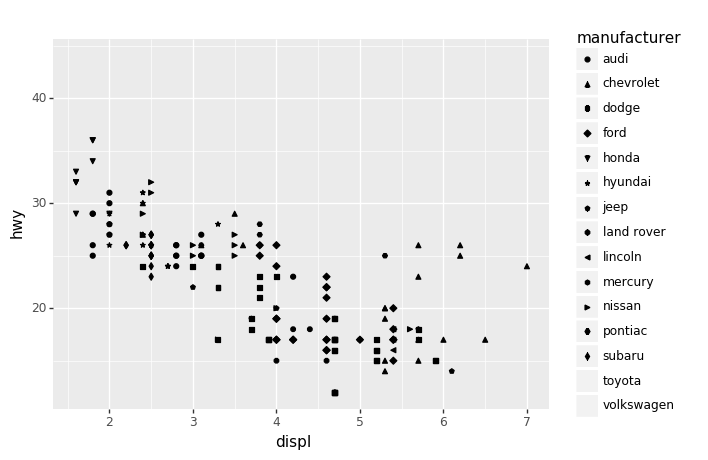

<ggplot: (-9223371871808170620)>

In [8]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy", shape="manufacturer"))

### Попробуйте сделать два графика: в одном размер точек будет соответствовать столбцу с элементами-категориями, во втором – столбцу с элементами-значениями

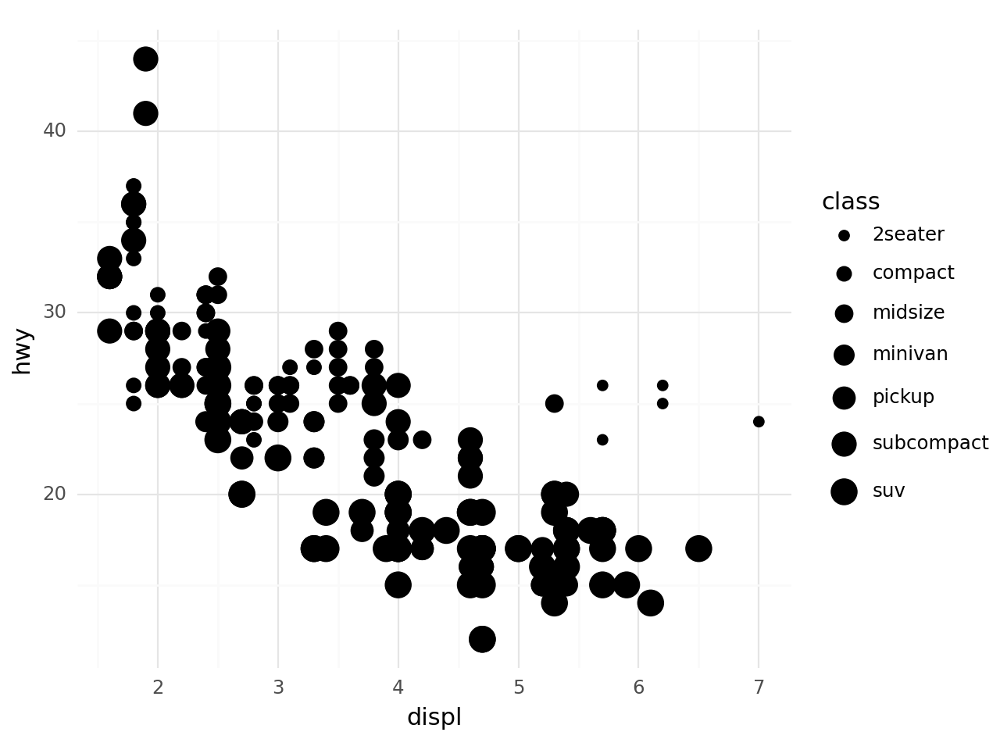

In [6]:
# Игнорировать предупреждения
warnings.filterwarnings('ignore')

# Загрузить данные mpg
mpg_data = mpg

# Первый график: размер точек соответствует столбцу "class"
p1 = ggplot(mpg_data, aes(x='displ', y='hwy', size='class')) + geom_point() + theme_minimal()
print(p1)

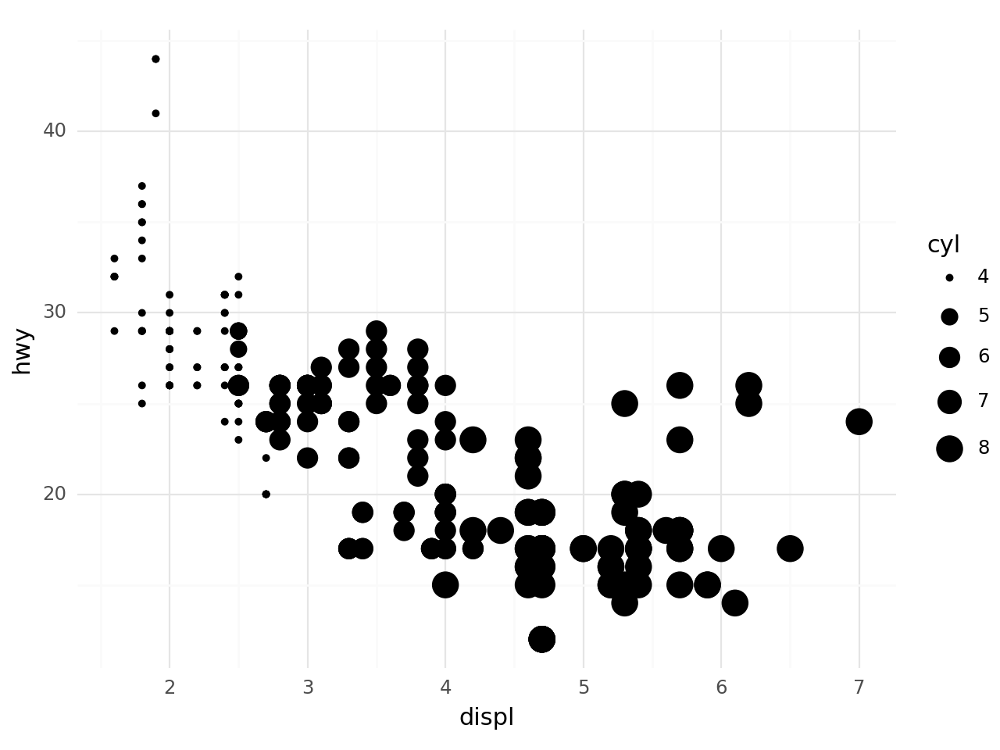

In [7]:
# Второй график: размер точек соответствует столбцу "cyl"
p2 = ggplot(mpg_data, aes(x='displ', y='hwy', size='cyl')) + geom_point() + theme_minimal()
print(p2)

## А что если сделать использовать в качестве источника визуального свойства "форма" непрерывную категорию (например hwy)?

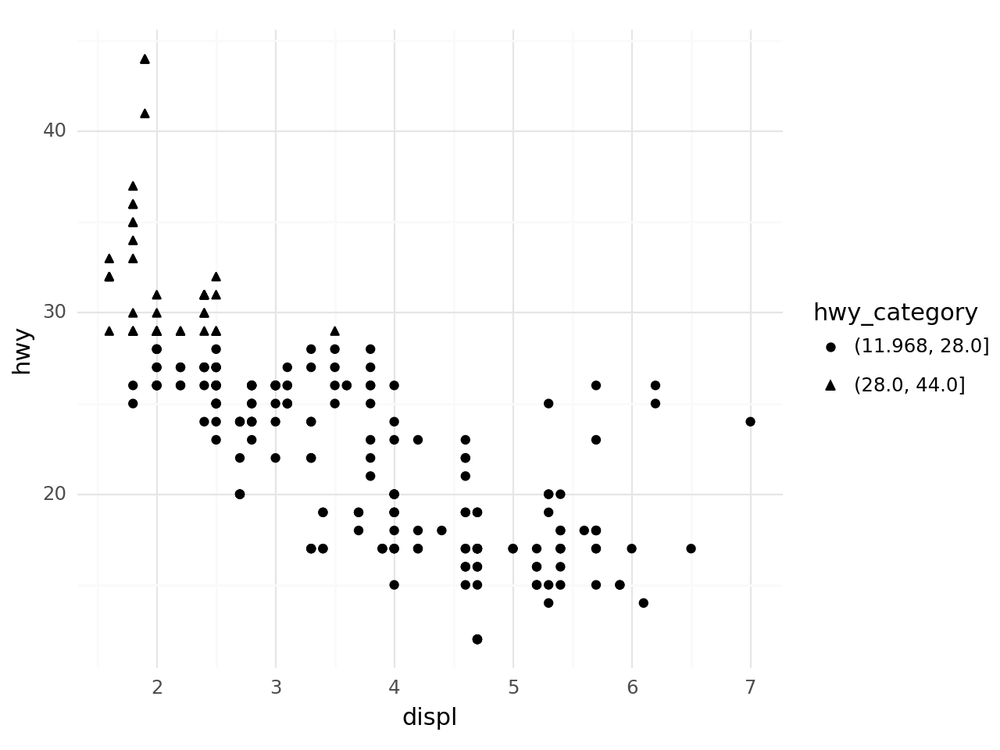

In [12]:
# Загрузить данные mpg
mpg_data = mpg

# Дискретизировать значения "hwy" и преобразовать в категории
mpg_data['hwy_category'] = pd.cut(mpg_data['hwy'], bins=2)  

# График: форма точек зависит от столбца "hwy_category"
p = ggplot(mpg_data, aes(x='displ', y='hwy', shape='hwy_category')) + geom_point() + theme_minimal()
print(p)

### Попробуйте сделать график с визуальным элементом, заданным условным оператором (например, color="displ < 5")

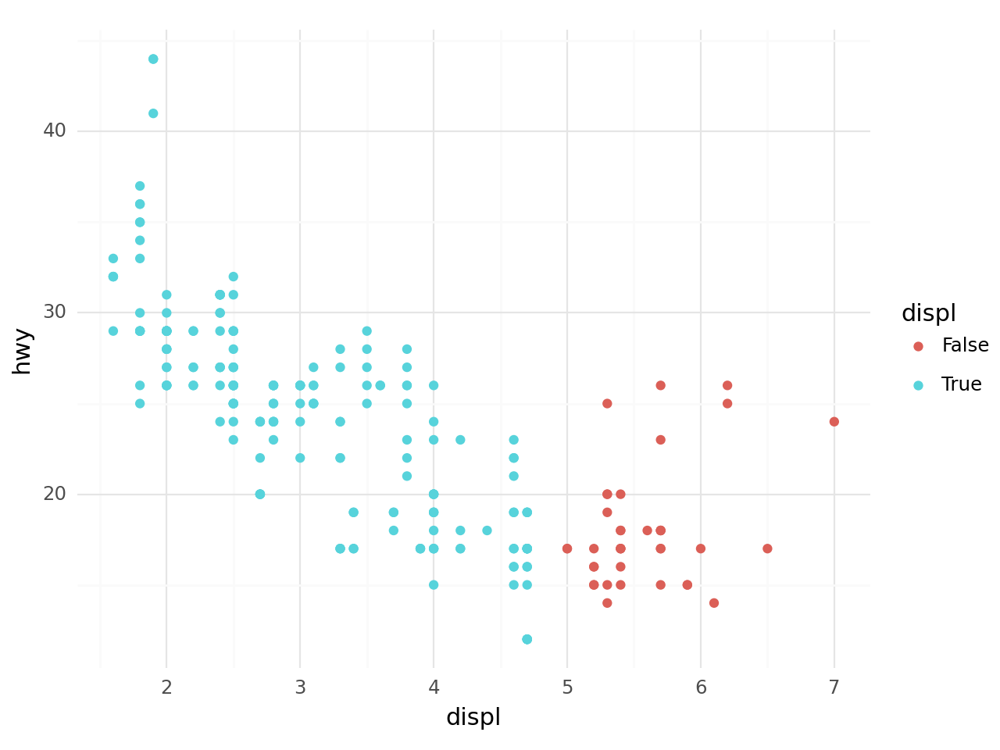

In [13]:
# График: цвет точек зависит от условия "displ < 5"
p = ggplot(mpg_data, aes(x='displ', y='hwy', color=(mpg_data['displ'] < 5))) + geom_point() + theme_minimal()
print(p)

### Попробуйте поэкспериментировать с графиками, где одной категории соответствуют различные визуальные элементы (пример ниже). Попробуйте привести пример, когда это имеет смысл.

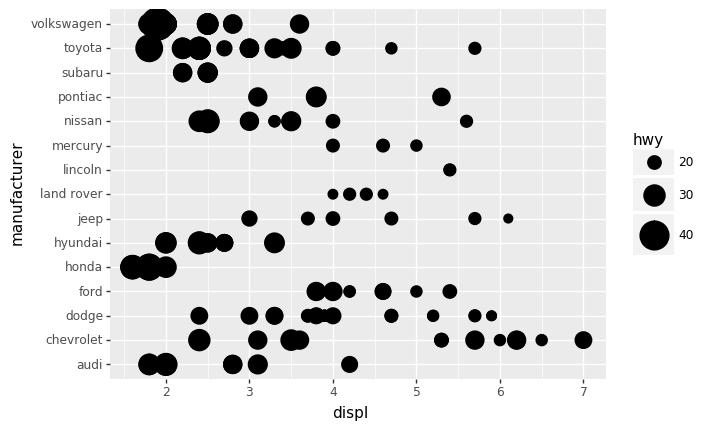

<ggplot: (-9223371871808028632)>

In [13]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="manufacturer", stroke="hwy"))

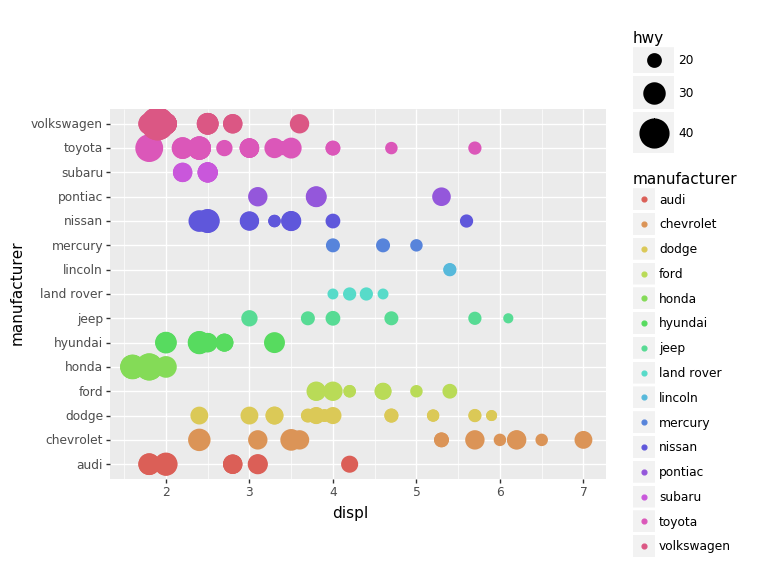

<ggplot: (-9223371871807959108)>

In [14]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="manufacturer", stroke="hwy", color="manufacturer"))

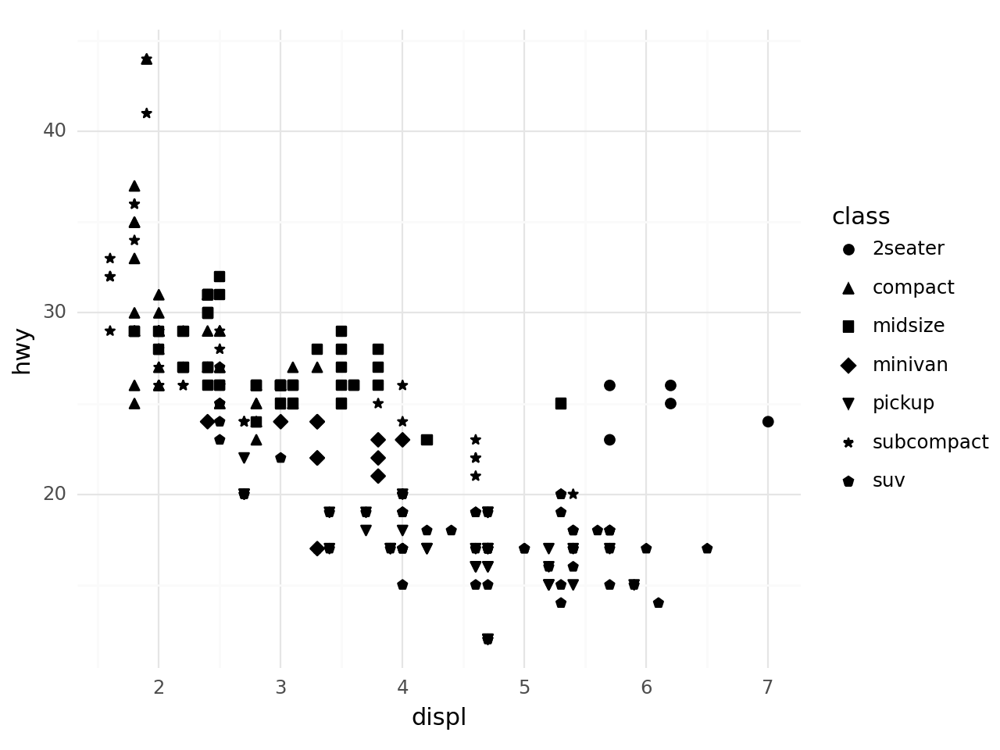

In [18]:
# Создать график, где различным классам "class" соответствуют разные маркеры
p = ggplot(mpg_data, aes(x='displ', y='hwy', shape='class')) + geom_point(size=2) + theme_minimal()
print(p)

## Использование панелей при визуализации

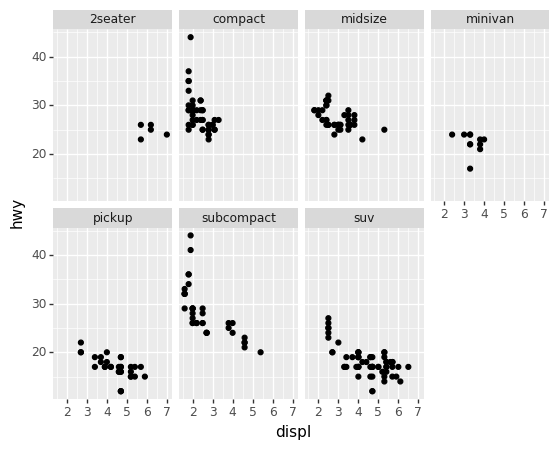

<ggplot: (-9223371871808784336)>

In [16]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy")) +\
facet_wrap("class", nrow=2)

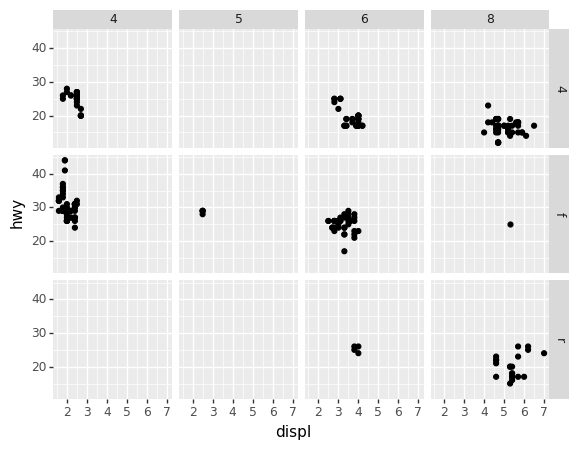

<ggplot: (-9223371871808092076)>

In [17]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy")) +\
facet_grid("drv ~ cyl")

### Что если использовать категорию с непрерывными значениями (например, hwy) для разделения на панели?

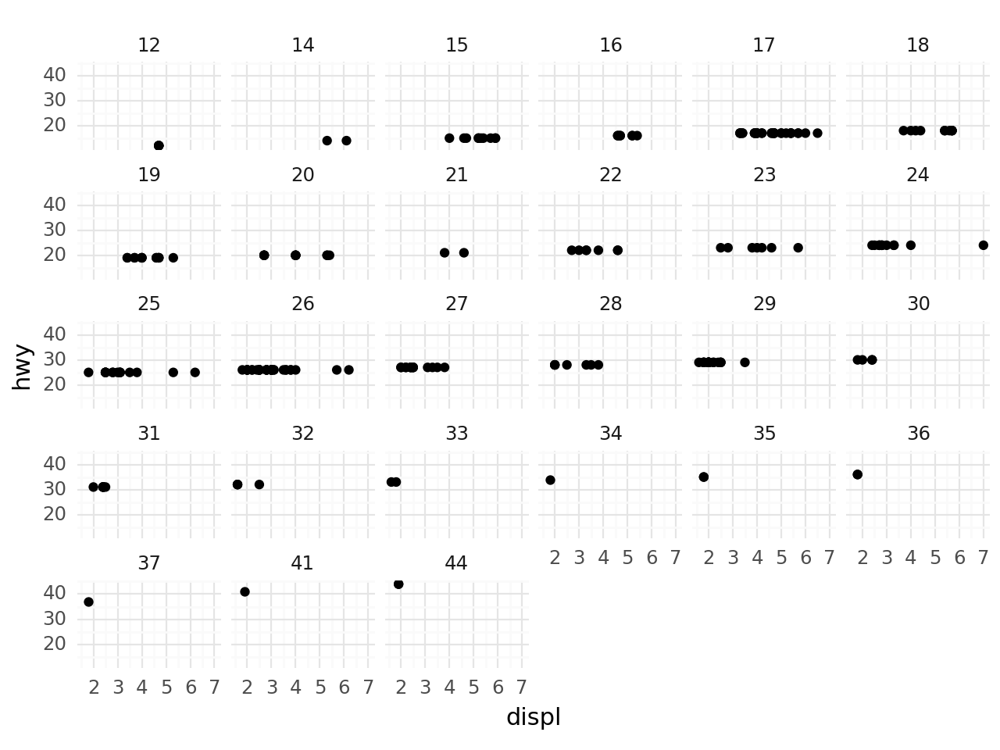

In [19]:
# Создать график с разделением на панели по столбцу "hwy"
p = ggplot(mpg_data, aes(x='displ', y='hwy')) + geom_point() + facet_wrap('~ hwy') + theme_minimal()
print(p)

### Можно сделать только вертикальные или только горизонтальные панели, если использовать конструкцию типа (". ~ <категория>")

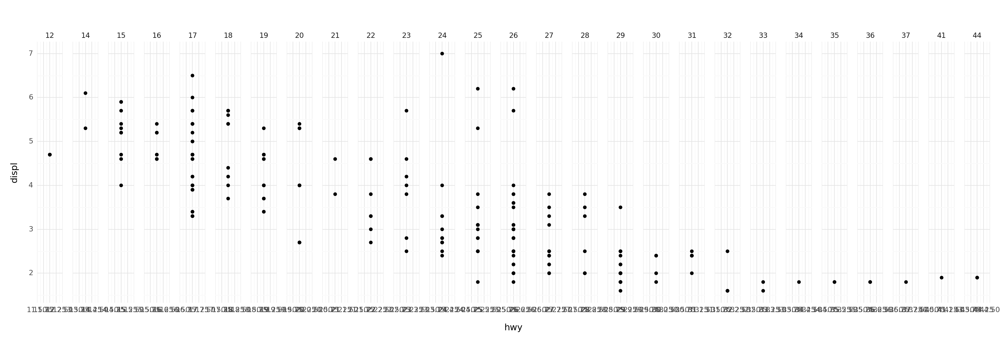

In [30]:
# Создать график с вертикальными панелями по столбцу "hwy"
p_vertical = ggplot(mpg_data, aes(x='displ', y='hwy')) + geom_point() + facet_grid('. ~ hwy', scales='free') + coord_flip() + theme_minimal() + theme(figure_size=(17, 6))


print(p_vertical)

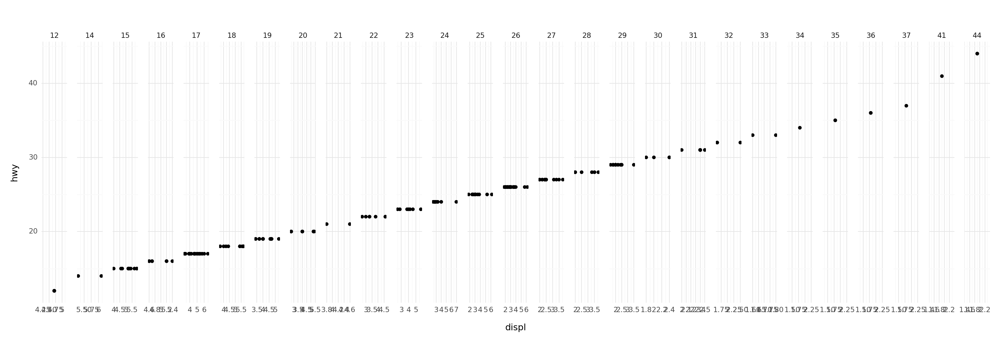

In [29]:
# Создать горизонтальные панели по столбцу "hwy"
p_horizontal = ggplot(mpg_data, aes(x='displ', y='hwy')) + geom_point() + facet_grid('. ~ hwy', scales='free') + theme_minimal() + theme(figure_size=(17, 6))

# Вывести оба графика
print(p_horizontal)

### Что лучше использовать: цвета или панели? А для большого набора?

Если небольшой набор данных и вы хотите выделить различные категории, цвета могут быть более эффективным вариантом.
Если большой набор данных или вы хотите сравнить различные категории, панели могут обеспечить лучшую структуру и читаемость графика.
Важно провести несколько экспериментов с различными вариантами и визуализациями для вашего конкретного случая и выбрать тот, который лучше соответствует вашим целям и легко читается вашей аудиторией.

## geom_smooth() позволяет получить сглаженную среднюю (в том числе, с доверительным интервалом).abs
### (это не сработает без библиотеки scikit-misc, и может не сработать даже с ней)

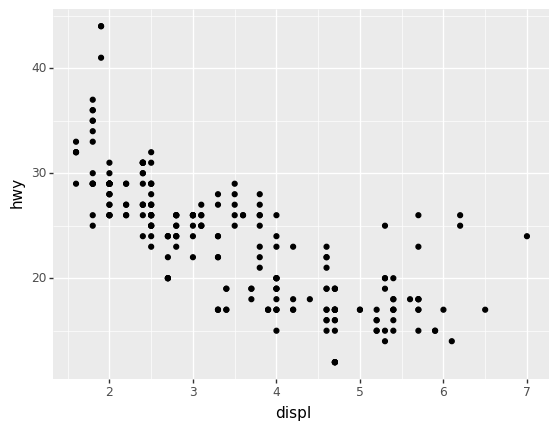

<ggplot: (-9223371871807518736)>

In [21]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy"))

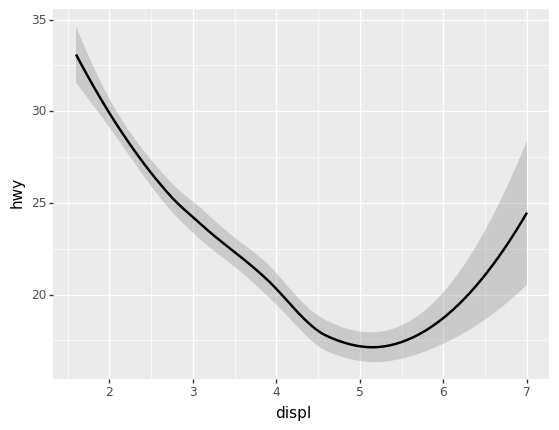

<ggplot: (-9223371871807511032)>

In [22]:
ggplot(data=mpg) +\
geom_smooth(mapping=aes(x="displ", y="hwy"))

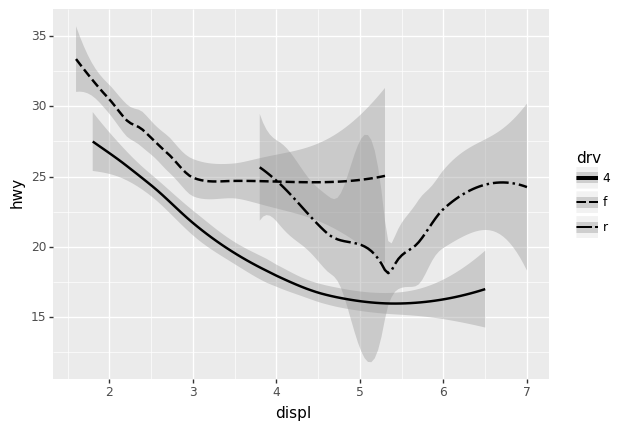

<ggplot: (-9223371871808182848)>

In [23]:
ggplot(data=mpg) +\
geom_smooth(mapping=aes(x="displ", y="hwy", linetype="drv"))

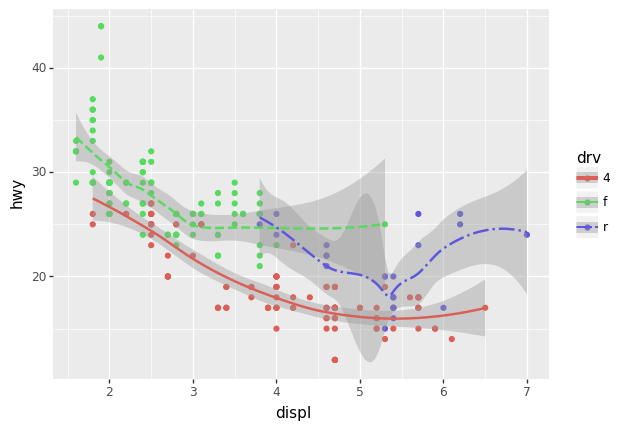

<ggplot: (-9223371871807172476)>

In [51]:
ggplot(data=mpg, mapping=aes(x="displ", y="hwy", color="drv")) +\
geom_point() +\
geom_smooth(mapping=aes(linetype="drv"))

## Визуальные отображения в функции ggplot будут распространяться на все графики. Отдельные свойства каждого геометрического отображения будут относиться только к нему.

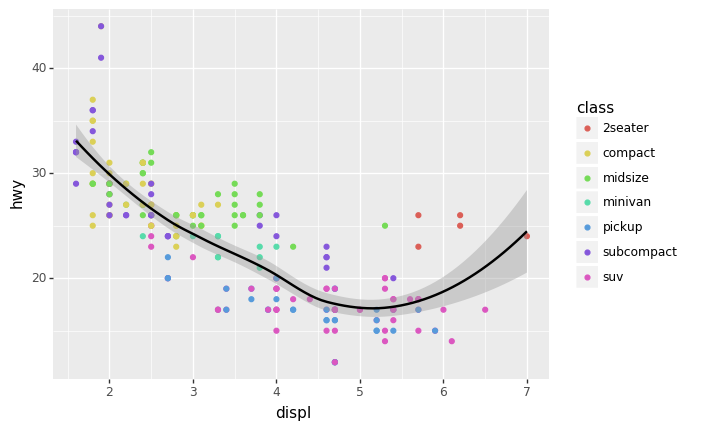

<ggplot: (-9223371871807386280)>

In [25]:
ggplot(data=mpg, mapping=aes(x="displ", y="hwy")) +\
geom_point(mapping=aes(color="class")) +\
geom_smooth()

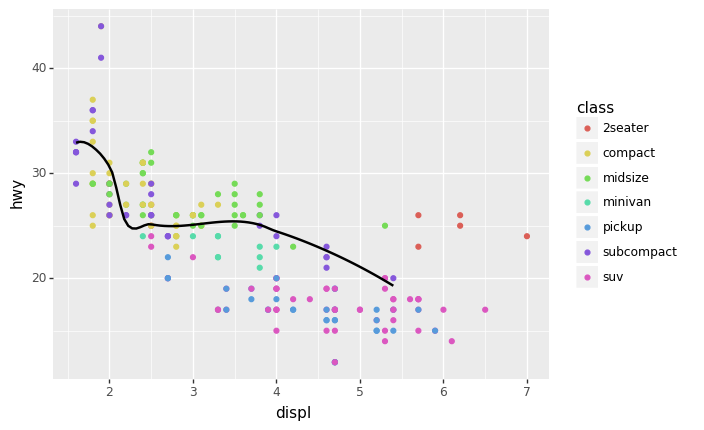

<ggplot: (-9223371871807266692)>

In [26]:
ggplot(data=mpg, mapping=aes(x="displ", y="hwy")) +\
geom_point(mapping=aes(color="class")) +\
geom_smooth(data=mpg.loc[mpg["class"] == "subcompact"], se=False)

## Попробуйте скомбинировать разные свойства разных слоёв

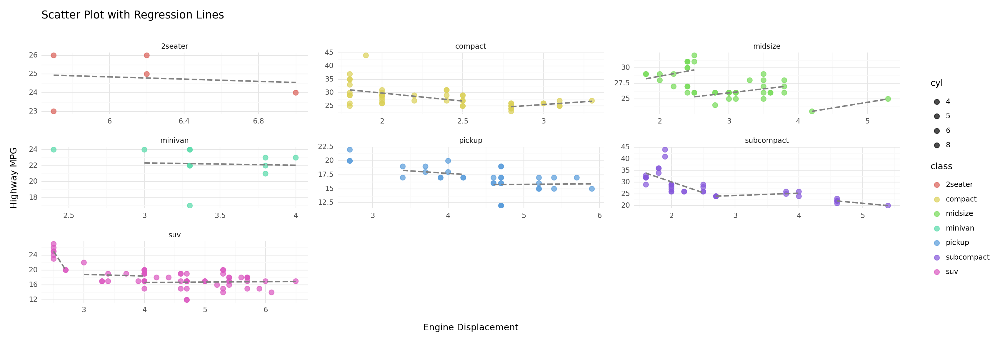

In [38]:
# Преобразовать столбец "cyl" в категориальный формат
mpg_data['cyl'] = mpg_data['cyl'].astype('category')

# Создать график с использованием различных свойств
p = ggplot(mpg_data, aes(x='displ', y='hwy', color='class', shape='cyl')) + \
    geom_point(size=3, alpha=0.7) + \
    geom_smooth(method='lm', se=False, color='gray', linetype='dashed') + \
    facet_wrap('~ class', scales='free') + \
    labs(title='Scatter Plot with Regression Lines', x='Engine Displacement', y='Highway MPG') + \
    theme_minimal() + \
    scale_shape_manual(values=["o", "o", "o", "o", "o", "o"]) + \
    theme(figure_size=(17, 6))  # Используем theme для изменения размера графика


# Вывести график
print(p)

# Какое геометрическое отображение вы будете использовать, чтобы нарисовать линейную диаграмму (обычный линейный график)?

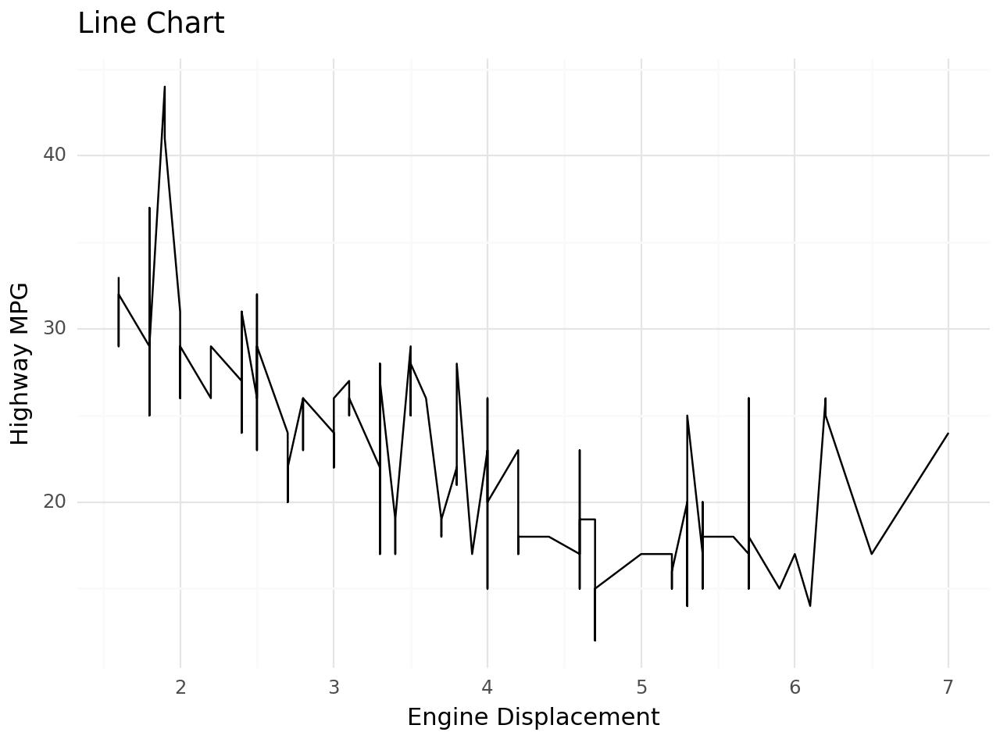

In [39]:
# Обычный линейный график
# Создать линейную диаграмму
p = ggplot(mpg_data, aes(x='displ', y='hwy')) + \
    geom_line() + \
    labs(title='Line Chart', x='Engine Displacement', y='Highway MPG') + \
    theme_minimal()

# Вывести график
print(p)

### Подберите подходящий код под следующие графики:
<img src="supp/p1.png" alt="Drawing" style="width: 350px;"/>
<img src="supp/p2.png" alt="Drawing" style="width: 350px;"/></br>
<img src="supp/p3.png" alt="Drawing" style="width: 350px;"/>
<img src="supp/p4.png" alt="Drawing" style="width: 350px;"/></br>
<img src="supp/p5.png" alt="Drawing" style="width: 350px;"/>
<img src="supp/p6.png" alt="Drawing" style="width: 350px;"/>

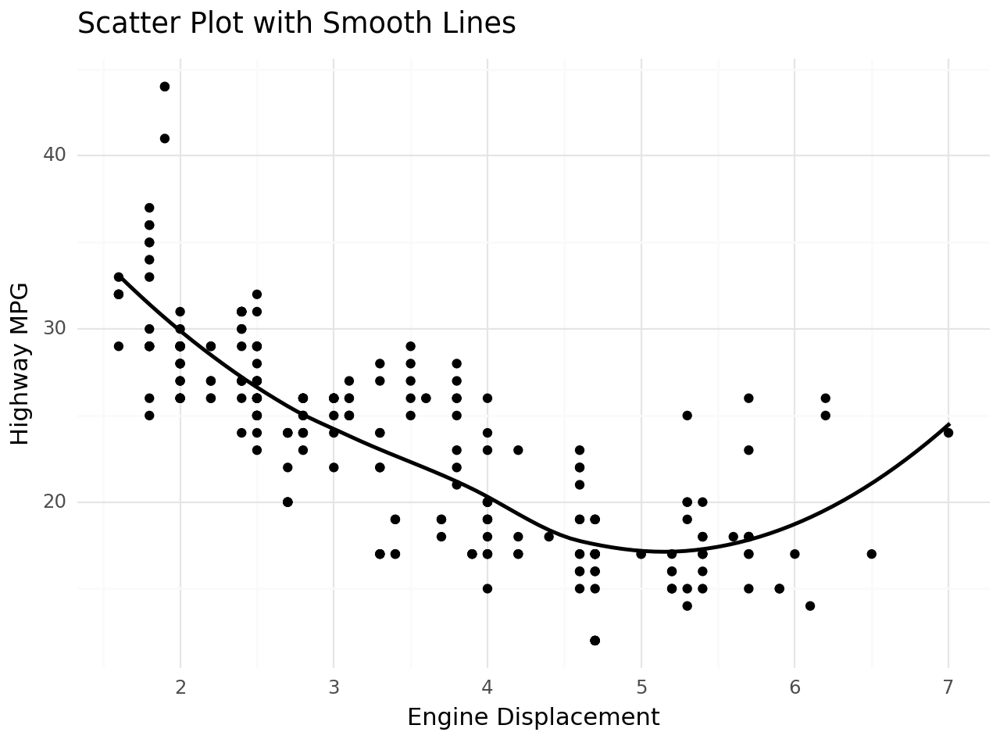

In [72]:
# Создать график с точками и плавными линиями (черными)
smooth_plot = ggplot(data=mpg_data, mapping=aes(x="displ", y="hwy", color="drv")) +\
    geom_point(color='black') + \
    geom_smooth(mapping=aes(linetype="drv"), method='loess', color='black', se=False, linetype='-') + \
    labs(title='Scatter Plot with Smooth Lines', x='Engine Displacement', y='Highway MPG') + \
    theme_minimal()

# Вывести график
print(smooth_plot)

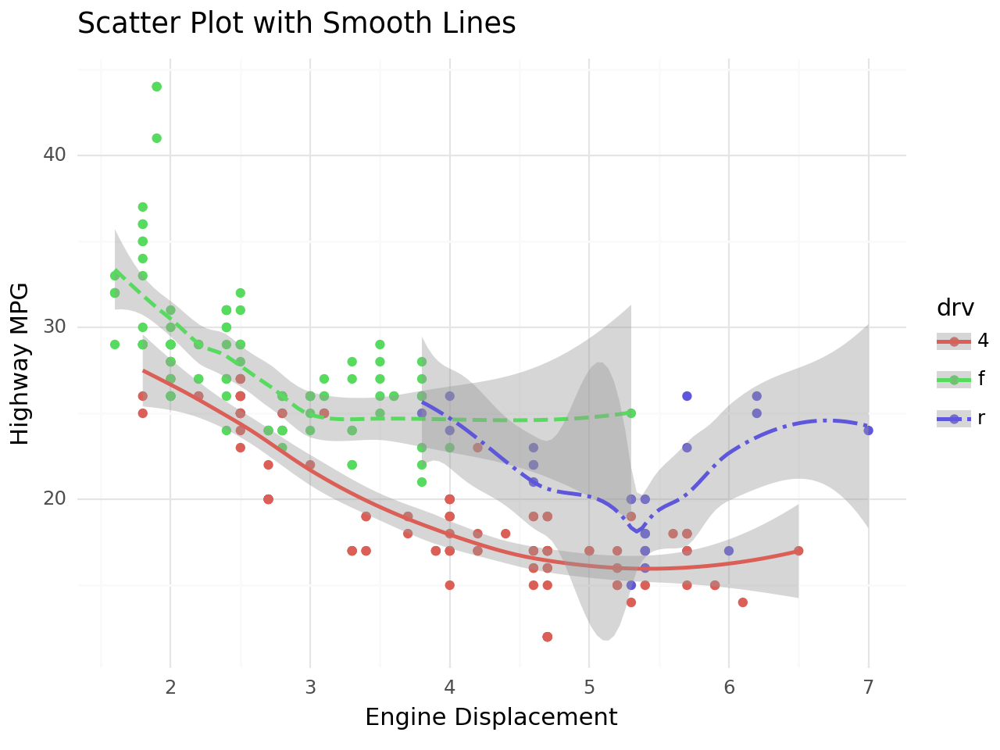

In [66]:
from skmisc.loess import loess

# Создать график с точками и плавными линиями
smooth_plot = ggplot(data=mpg_data, mapping=aes(x="displ", y="hwy", color="drv")) +\
    geom_point() + \
    geom_smooth(mapping=aes(linetype="drv"), method='loess') + \
    labs(title='Scatter Plot with Smooth Lines', x='Engine Displacement', y='Highway MPG') + \
    theme_minimal()

# Вывести график
print(smooth_plot)

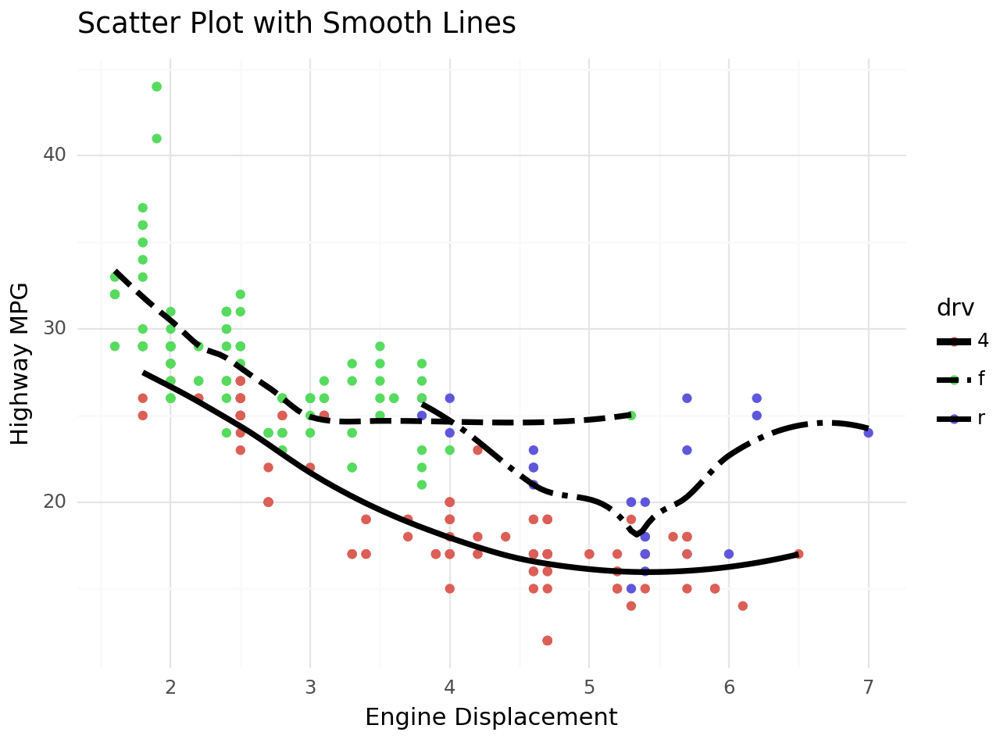

In [76]:
# Создать график с точками и линиями для каждого класса (цвета сохранены)
smooth_plot = ggplot(data=mpg_data, mapping=aes(x="displ", y="hwy", color="drv")) +\
    geom_point() + \
    geom_smooth(data=mpg_data, mapping=aes(x="displ", y="hwy", linetype="drv"), method='loess', color='black', se=False, size=1.5) + \
    labs(title='Scatter Plot with Smooth Lines', x='Engine Displacement', y='Highway MPG') + \
    theme_minimal()
# Вывести график
print(smooth_plot)

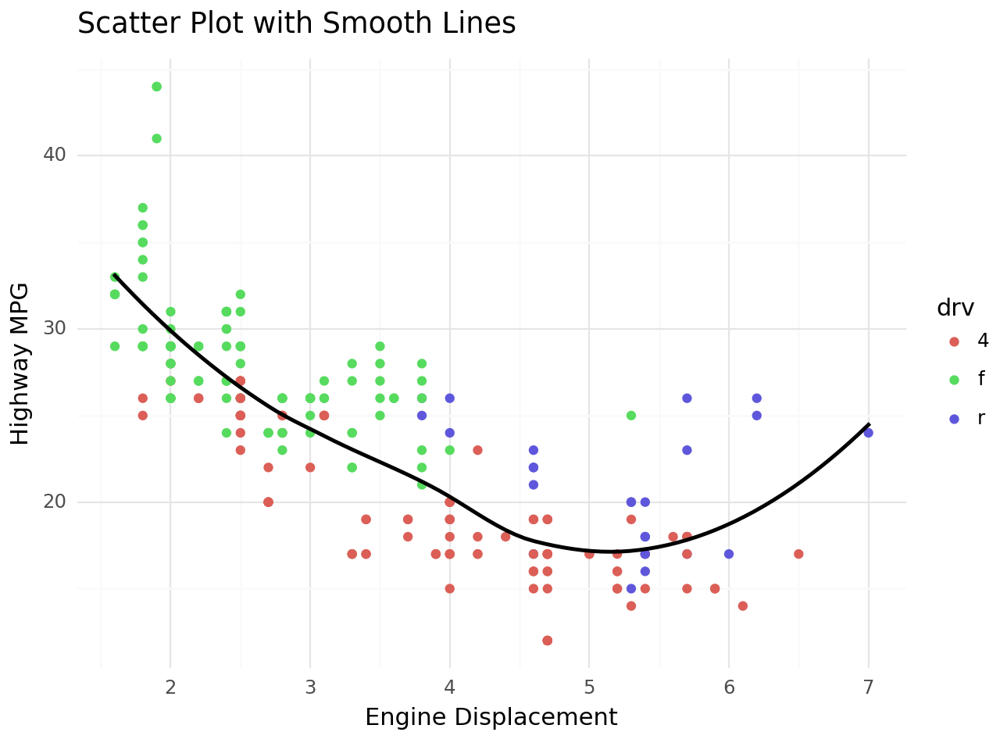

In [82]:
# Создать график с точками и линиями для каждого класса (цвета сохранены)

# Создать график с точками и линиями для каждого класса (цвета сохранены)
smooth_plot = ggplot(data=mpg_data, mapping=aes(x="displ", y="hwy", color="drv")) +\
    geom_point() + \
    geom_smooth(data=mpg_data, mapping=aes(x="displ", y="hwy"), method='loess', color='black', se=False, linetype='-') + \
    labs(title='Scatter Plot with Smooth Lines', x='Engine Displacement', y='Highway MPG') + \
    theme_minimal()

# Вывести график
print(smooth_plot)

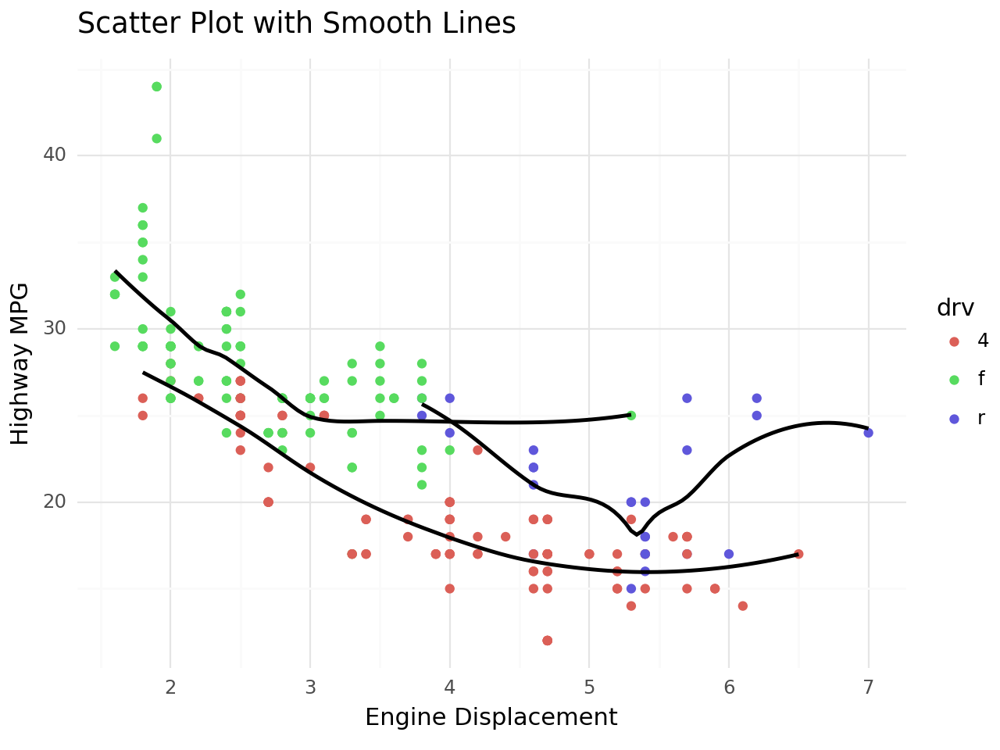

In [87]:
# Создать график с точками и плавными линиями
smooth_plot = ggplot(data=mpg_data, mapping=aes(x="displ", y="hwy", color="drv")) +\
    geom_point() + \
    geom_smooth(mapping=aes(group='drv'), method='loess', color='black', se=False, size=1, linetype='solid') + \
    labs(title='Scatter Plot with Smooth Lines', x='Engine Displacement', y='Highway MPG') + \
    theme_minimal()
# Вывести график
print(smooth_plot)

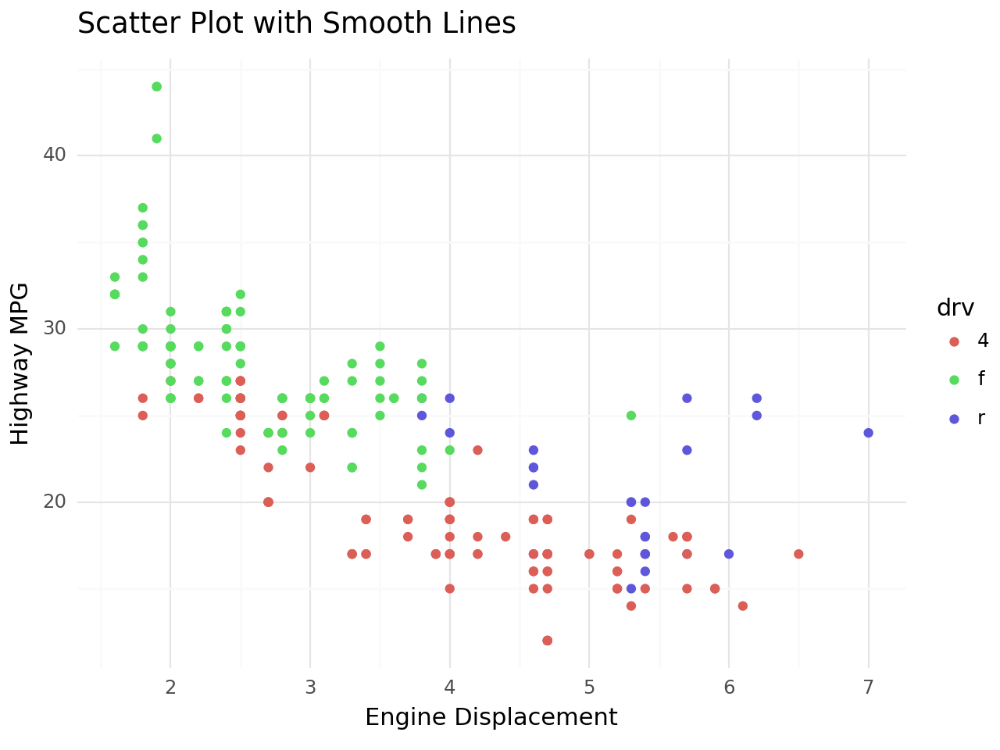

In [77]:
# Создать график с точками и плавными линиями
smooth_plot = ggplot(data=mpg_data, mapping=aes(x="displ", y="hwy", color="drv")) +\
    geom_point() + \
    labs(title='Scatter Plot with Smooth Lines', x='Engine Displacement', y='Highway MPG') + \
    theme_minimal()

# Вывести график
print(smooth_plot)

## Статистические свойства элементов категорий

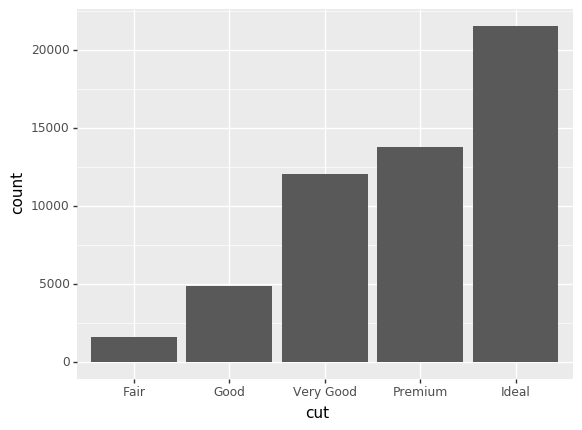

<ggplot: (-9223371871807217240)>

In [35]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut"))

### Что делает geom_col()? Чем он отличается от geom_bar()?

Использование данных:
- geom_col(): Ожидает, что данные будут предварительно агрегированы. То есть, вы передаете высоту столбца (или значения y) в виде переменной в данных.
- geom_bar(): Может работать с неагрегированными данными, принимая на вход переменные x и y. Если y не указан, он подразумевается как количество наблюдений в каждой категории.

Представление данных:
- geom_col(): Обычно используется, когда вы уже имеете высоту столбцов или хотите представить данные в виде прямоугольных столбцов с фиксированной шириной.
- geom_bar(): Часто используется, когда вы хотите подсчитать количество наблюдений в каждой категории и построить столбцы, представляющие эти значения.

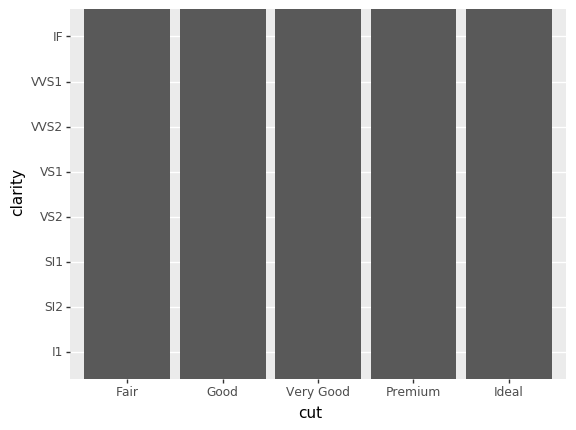

<ggplot: (-9223371871807350972)>

In [37]:
ggplot(data=diamonds) +\
geom_col(mapping=aes(x="cut", y="clarity"))

### Что произойдёт, если 
'ggplot(data=diamonds) +\
'geom_bar(mapping=aes(x="cut", y="..prop.."), group=1)
или
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="color", y="..prop.."))
### запустить без "group=1"? Почему?

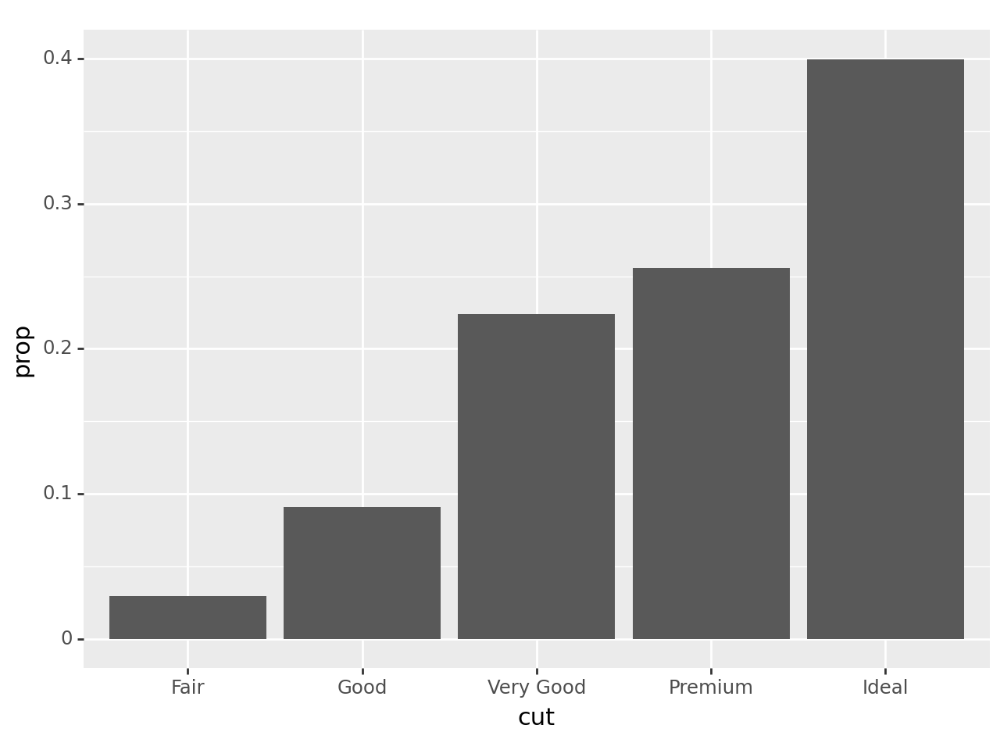

<Figure Size: (640 x 480)>

In [40]:
ggplot(data=diamonds) +\
    geom_bar(mapping=aes(x="cut", y="..prop.."), group=1)

..prop.. используется для отображения доли вместо абсолютных значений.
group=1 создает общую группу для всех столбцов, что позволяет корректно рассчитывать доли на основе общего количества.
Если вы уберете group=1, то ..prop.. будет рассчитываться относительно каждой категории отдельно. Таким образом, столбцы в каждой категории будут представлять долю от общего количества в этой категории, а не от общего количества во всех категориях вместе.

fill="color" в geom_bar():
fill="color" используется для закрашивания столбцов в соответствии с переменной "color" в данных.
Если убрать group=1, это не повлияет на fill="color", так как group не используется для цветового заполнения столбцов.
В обоих случаях важно понимать, какие данные вы визуализируете, и какие результаты ожидаете. Наличие или отсутствие group=1 может влиять на обработку данных при построении графика.

## Модные графики с красивыми цветами

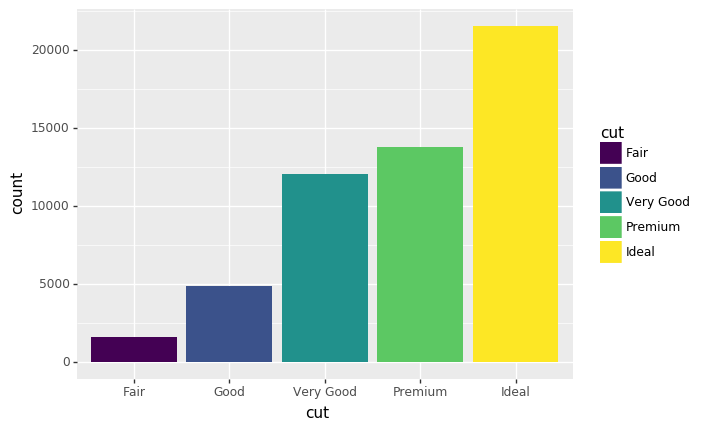

<ggplot: (-9223371871807233136)>

In [40]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="cut"))

## При добавлении новых категорий в качестве цвета появляется новая функциональность

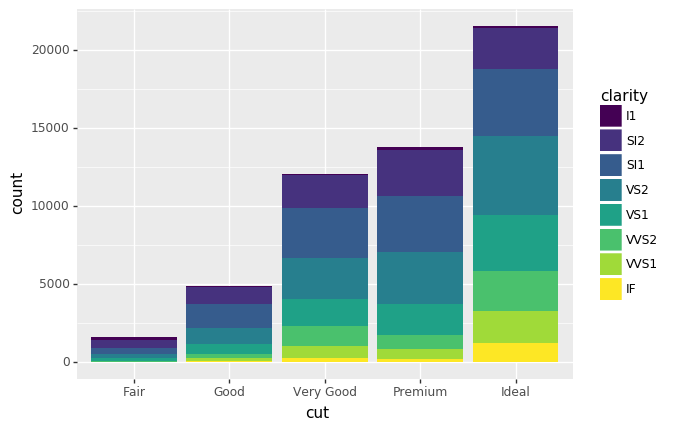

<ggplot: (-9223371871807213256)>

In [41]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="clarity"))

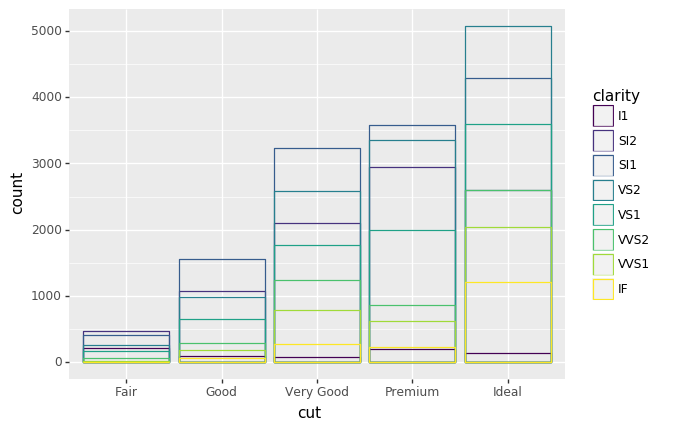

<ggplot: (-9223371871807570776)>

In [42]:
ggplot(data=diamonds, mapping=aes(x="cut", colour="clarity")) +\
geom_bar(fill=None, position="identity")

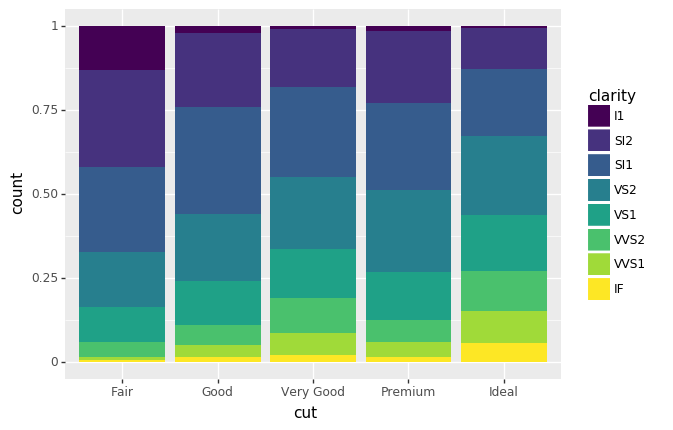

<ggplot: (-9223371871807389036)>

In [43]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="clarity"), position="fill")

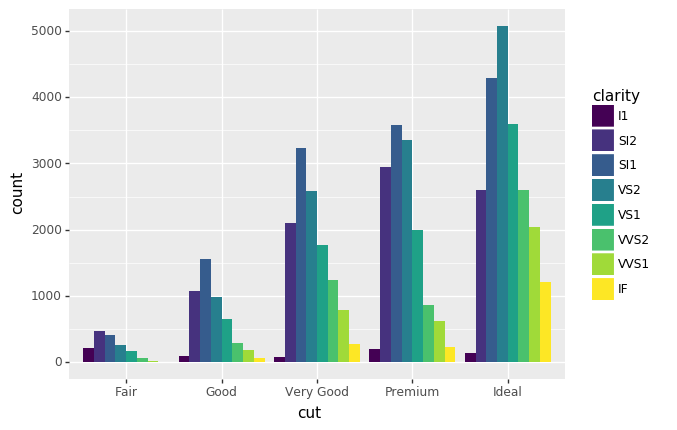

<ggplot: (-9223371871807689112)>

In [44]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="clarity"), position="dodge")

## Добавим jitter в scatter!

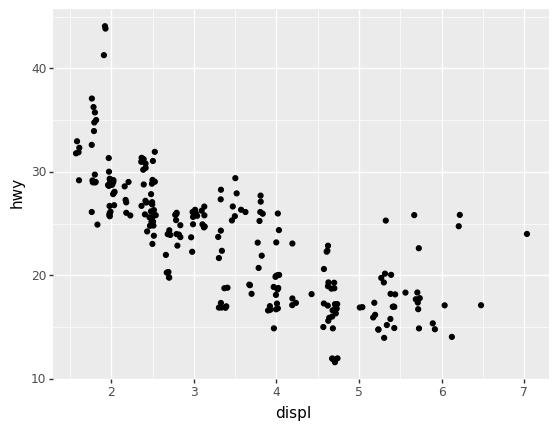

<ggplot: (-9223371871808166468)>

In [45]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy"), position="jitter")


### Зачем тут coord_fixed()? Что делает geom_abline()?

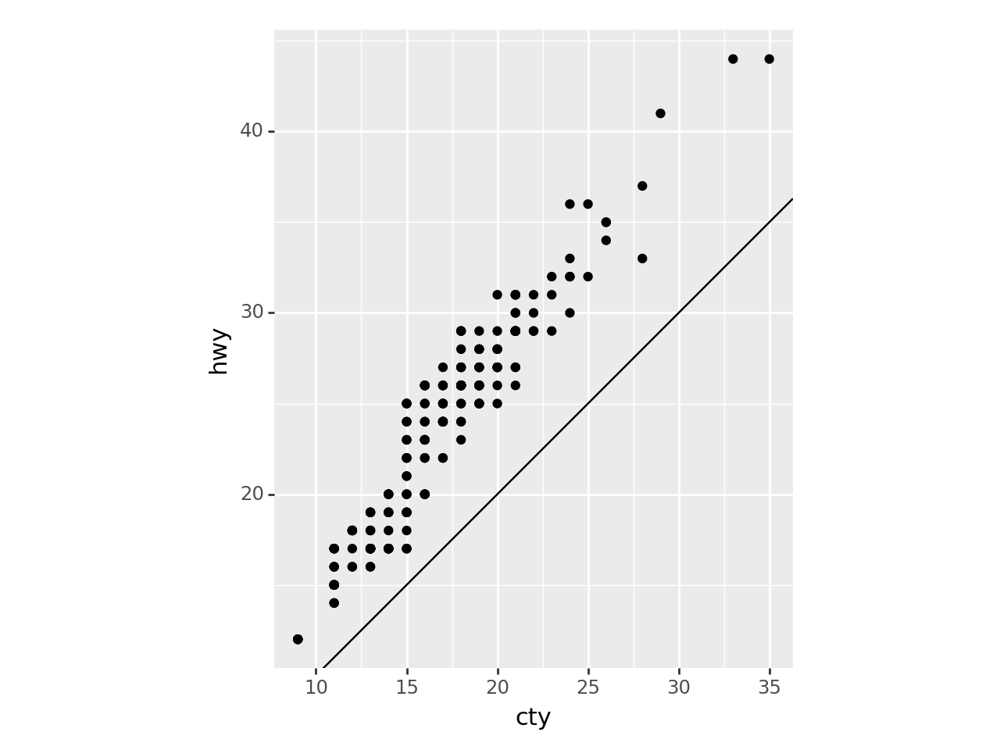

<Figure Size: (640 x 480)>

In [41]:
ggplot(data=mpg, mapping=aes(x="cty", y="hwy")) +\
geom_point() +\
geom_abline() +\
coord_fixed()


geom_abline() добавляет линию на график. В данном случае, поскольку вы не предоставляете никаких дополнительных аргументов для geom_abline(), она добавляет линию с угловым коэффициентом 1 и пересекающую ось y в 0. Таким образом, это будет линия под углом 45 градусов, представляющая равенство x = y.
coord_fixed():

coord_fixed() используется для фиксации соотношения масштабов по осям x и y. Это может быть полезно, если вам важно сохранить пропорции между значениями на обеих осях.

# Творческое задание
## Попробуйте использовать изученные средства plotnine для своего датасета (необязательно много и пока не надо строить сложные графики)

In [49]:
from plotnine import *

# Загрузить данные iris
diamonds_data = diamonds
diamonds_data

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


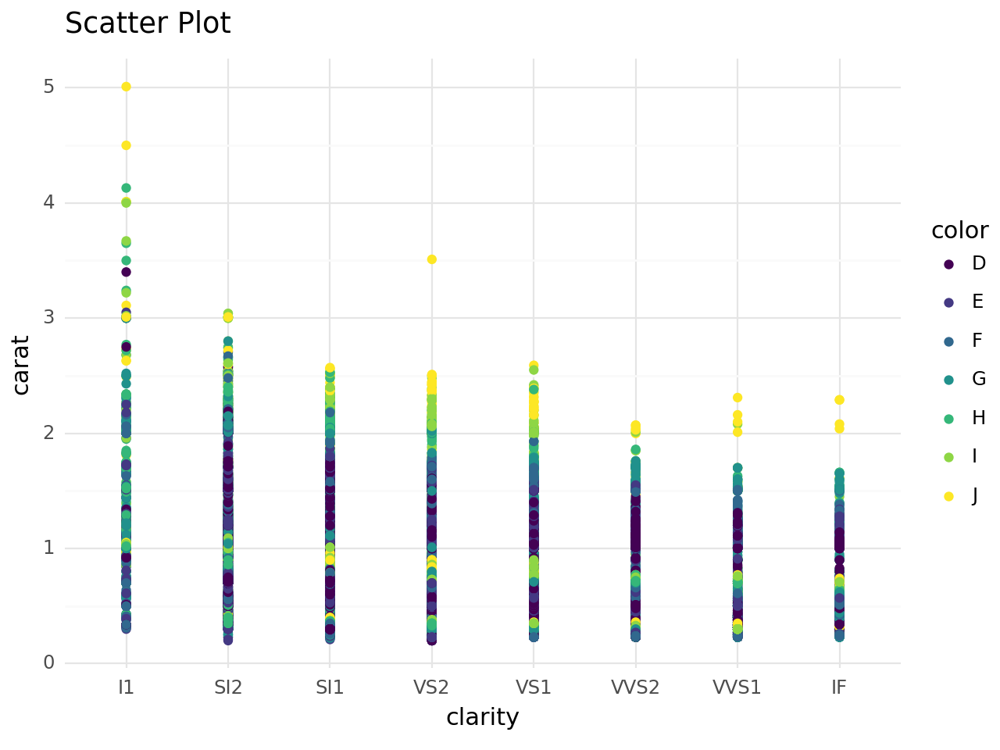

In [55]:
# Создать точечный график для переменных Sepal.Length и Sepal.Width
p = ggplot(diamonds_data, aes(x='clarity', y='carat', color='color')) + \
    geom_point() + \
    labs(title='Scatter Plot', x='clarity', y='carat') + \
    theme_minimal()

# Вывести график
print(p)


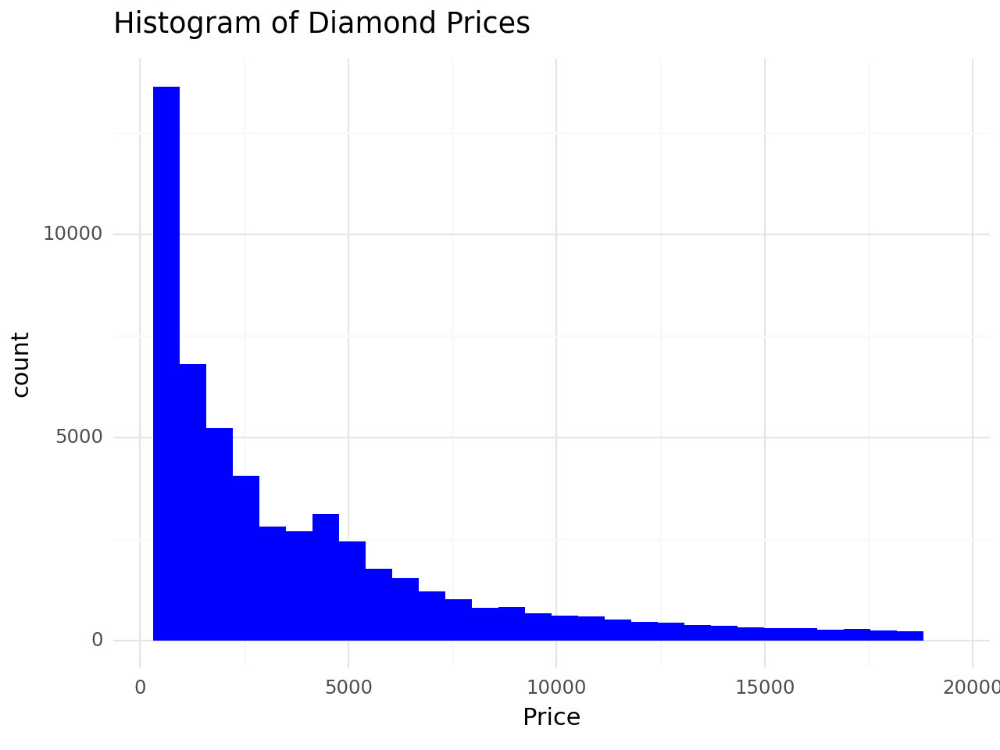

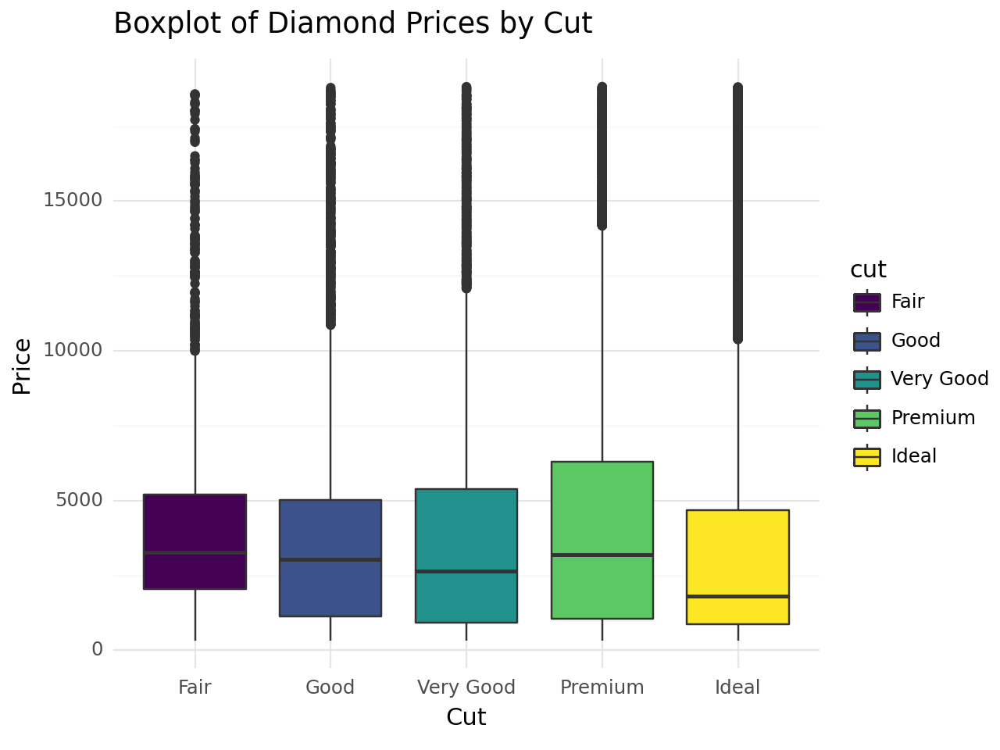

In [56]:
# Гистограмма для переменной price
histogram = ggplot(diamonds_data, aes(x='price')) + \
    geom_histogram(fill='blue', bins=30) + \
    labs(title='Histogram of Diamond Prices', x='Price') + \
    theme_minimal()

# Ящик с усами для переменной price в зависимости от cut
boxplot = ggplot(diamonds_data, aes(x='cut', y='price', fill='cut')) + \
    geom_boxplot() + \
    labs(title='Boxplot of Diamond Prices by Cut', x='Cut', y='Price') + \
    theme_minimal()

# Вывести графики
print(histogram)
print(boxplot)